# Basic Data Reduction
In this first notebook we will be conducting the basic data reduction. This includes correcting with the bias, flat and dark images, aligning our images and subtracting the skybackground. This code operates under the assumption that the data directory has been purged of all images that do not belong to our observations. 

### Collecting Data & importing libraries

In [1]:
from astropy.time import Time
from astropy.io import fits
import numpy as np
import astroalign as aa
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import pandas as pd
from photutils.background import ModeEstimatorBackground
from itertools import product

file_rows = []

base_dir = "/net/virgo01/data/users/tboersma/2025-04-30/"
data_dir = os.path.join(base_dir, 'raw_data')

file_list = sorted([f for f in os.listdir(data_dir) if f.endswith('.fits') or f.endswith('.fit')])

for fn in file_list:
    fp = os.path.join(data_dir, fn)
    
    hd = fits.getheader(fp)
    
    # Keep only raw files
    if hd['IMAGETYP'] not in ['LIGHT', 'BIAS', 'FLAT']:
        print(fp)
        continue
    if hd['IMAGETYP'] == 'LIGHT' and hd['FILTER'] != 'ND1.2':
        obj = "STARFIELD" if "STAR" in fp.upper() else "M81"
    else:
        obj = None

    row = {'FILENAME' : fn, 'FILEPATH' : fp,
           'IMAGETYP' : hd.get('IMAGETYP', None),
           'OBJECT' : obj,
           'FILTER' : hd.get('FILTER', None),
           'EXPTIME' :hd.get('EXPTIME', None)}

    file_rows.append(row)
file_df = pd.DataFrame(file_rows)
print(file_df, file_df['IMAGETYP'].unique(), file_df['FILTER'].unique())



/net/virgo01/data/users/tboersma/2025-04-30/raw_data/master_bias.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/master_dark.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/master_flat_B*.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/master_flat_G*.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/master_flat_H_alpha.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/master_flat_Lum.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/master_flat_R*.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_B*_0.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_B*_100.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_B*_101.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_B*_109.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_B*_110.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_B*_118.fits
/net/virgo01/data/users/tboer

/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_164.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_168.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_25.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_27.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_40.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_42.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_55.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_57.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_69.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_71.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_80.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_81.fits
/net/virgo01/data/users/tboersma/2025-04-30/raw_data/reduced_M81_R*_89.fits
/net/virgo

### Useful Functions
The code block below defines some useful functions to use throughout the notebook.

In [2]:
def load_data(files: list[str]) -> np.ndarray:
        data = np.array([fits.getdata(f) for f in files])
        return np.dstack(data)

def plot_image(data: np.ndarray | str, title: str, gray: bool = False) -> None:
        if isinstance(data, str):
            data = fits.getdata(data)
            
        fig, ax = plt.subplots(figsize=(10,8))
        img_display = ax.imshow(data, cmap='gray' if gray else 'viridis', vmin=np.percentile(data, 1), vmax=np.percentile(data, 99))
        cbar = fig.colorbar(img_display, ax=ax)

        ax.set_title(title, pad=20)
        ax.grid(False)
        plt.tight_layout()
        plt.show()

def write_fits(file_path, data, header, verbose=False, **kwargs) -> None:
    try:
        fits.writeto(file_path, data, header, **kwargs)
        if verbose:
            print(f"Succesfully wrote to {file_path}")
    except PermissionError:
        print(f"Failed to write to {file_path} (no permission)")
        return


### Master Bias
Next we compute the master bias. This is done by loading all the biases we took and taking the median across them. We write it back to the data disk.

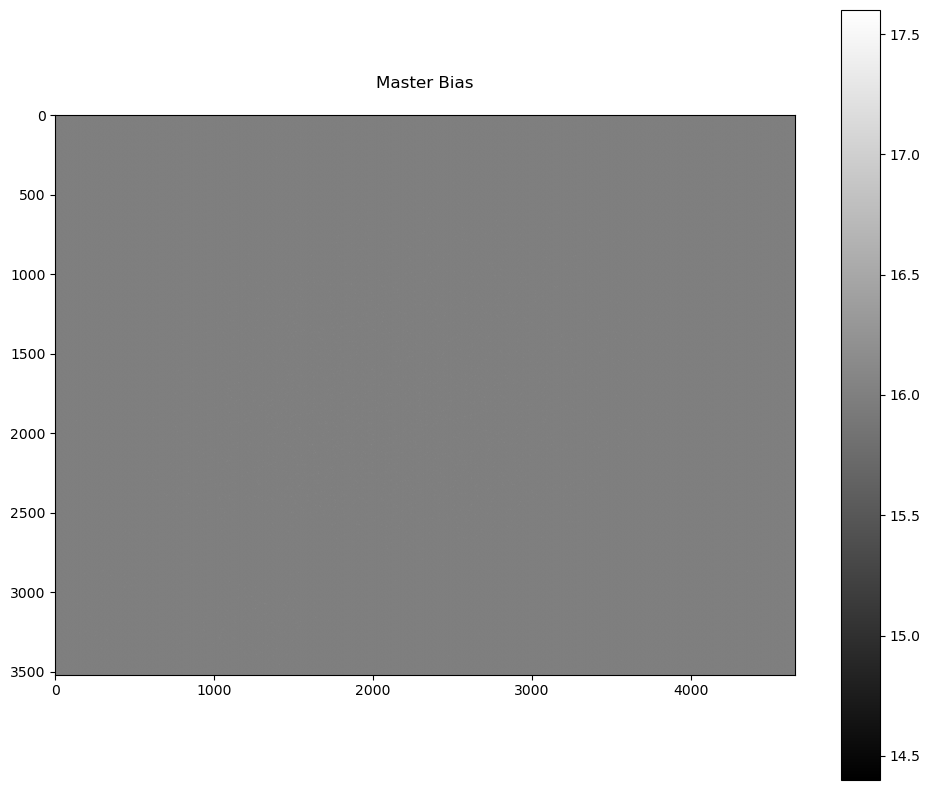

In [3]:
# Load
bias_files = file_df[file_df["IMAGETYP"] == 'BIAS']["FILEPATH"].tolist()
bias_data = load_data(bias_files)

# Compute
master_bias = np.median(bias_data, axis=-1)

# Save
header = fits.getheader(bias_files[0])
header['IMAGETYP'] = 'MASTER_BIAS'
header['NFRAMES'] = len(bias_data)
header['COMBINED'] = 'MEDIAN'
header['COMMENT'] = 'Master bias frame created from raw bias exposures'

write_fits(os.path.join(data_dir, 'master_bias.fits'), master_bias, header, overwrite=True)

# Show
plot_image(master_bias, "Master Bias", gray=True)



### Master Dark
Next we compute the master dark to use for the corrections. The dark is way to big and always dominates the images, so we decided not to use it. Even when ensuring it is scaled down to count/s and scaled back up by multipling by the exposure time of our galaxy/starfield images and including it in the Flat Field.

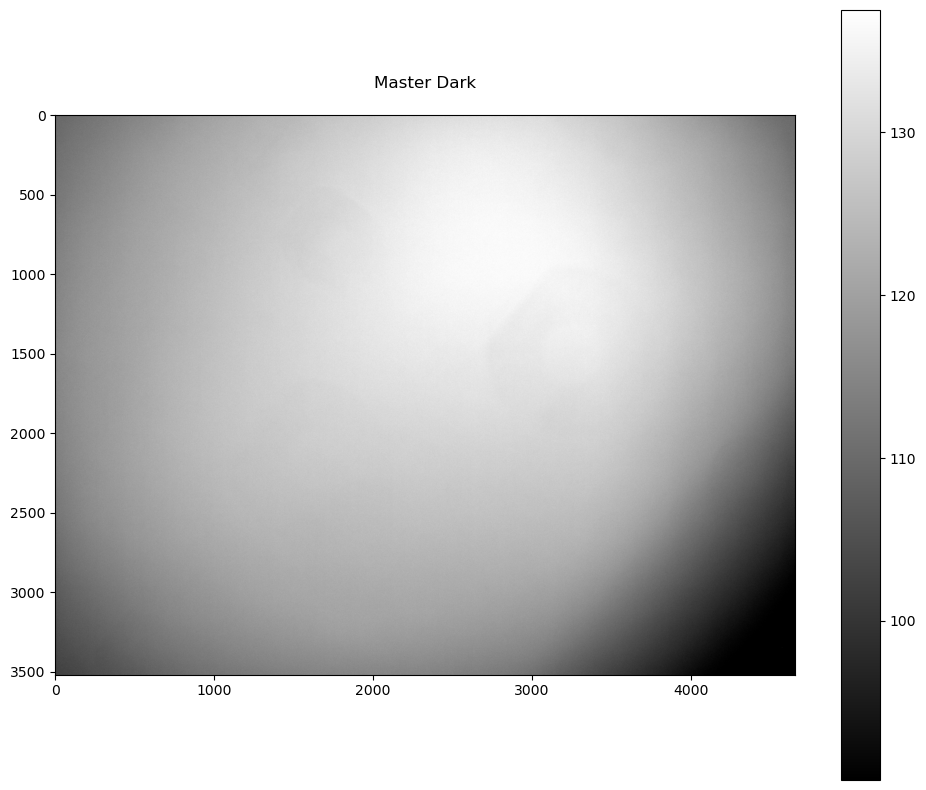

In [4]:
# Load
dark_files = file_df[file_df["FILTER"] == 'ND1.2']
master_bias = fits.getdata(os.path.join(data_dir, 'master_bias.fits'))



# Subtract bias then correct by exposure time and compute median
corrected_dark_data = np.array([(fits.getdata(dark['FILEPATH']) - master_bias) 
                                / dark['EXPTIME'] 
                                for _, dark in dark_files.iterrows()])
dark_stack = np.dstack(corrected_dark_data)
master_dark = np.median(dark_stack, axis=-1)

# Save
header = fits.getheader(bias_files[0])
header['IMAGETYP'] = 'MASTER_DARK'
header['NFRAMES'] = len(bias_data)
header['COMBINED'] = 'MEDIAN'
header['COMMENT'] = 'Master dark frame created from bias subtracted and exposure corrected dark exposures'

write_fits(os.path.join(data_dir, 'master_dark.fits'), master_dark, header, overwrite=True)

# Show
plot_image(master_dark, "Master Dark", gray=True)

### Master Flats
We compute the master flat images next. This is done by loading them, subtracting the master bias (which we also load to allow this code block to be ran independanlty of the last), normalizing the flat by dividing by the median and lastly taking the mean across all the flats taken for each filter. We then write these to the disk.

  0%|          | 0/5 [00:00<?, ?it/s]

Computing master flat for B*.


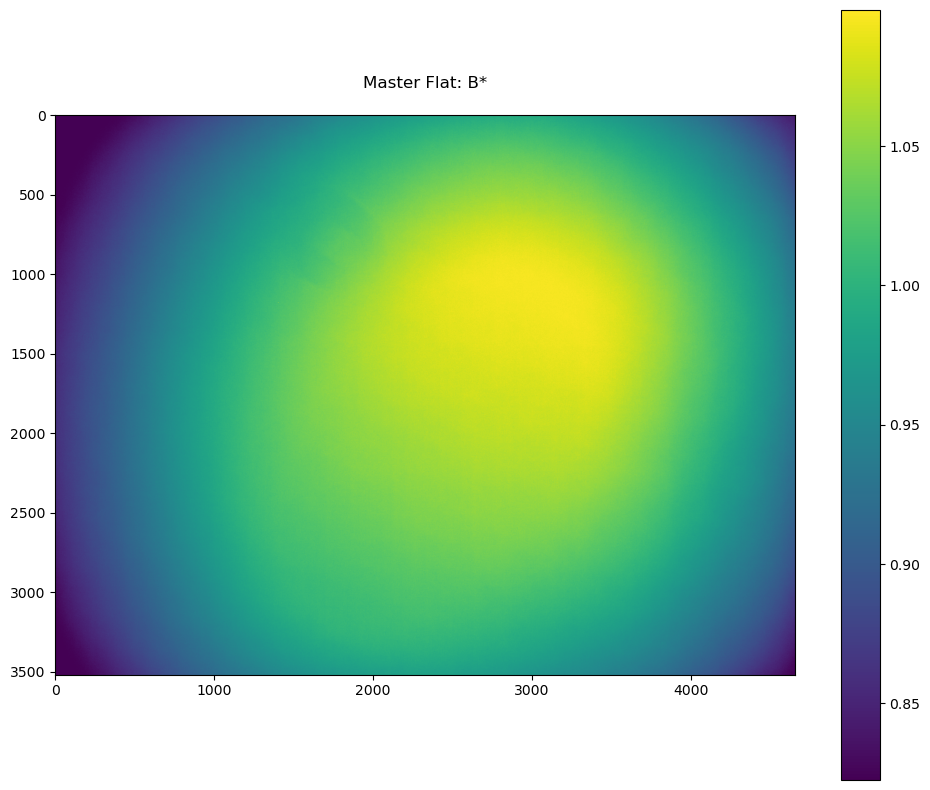

 20%|██        | 1/5 [00:06<00:25,  6.28s/it]

Computing master flat for G*.


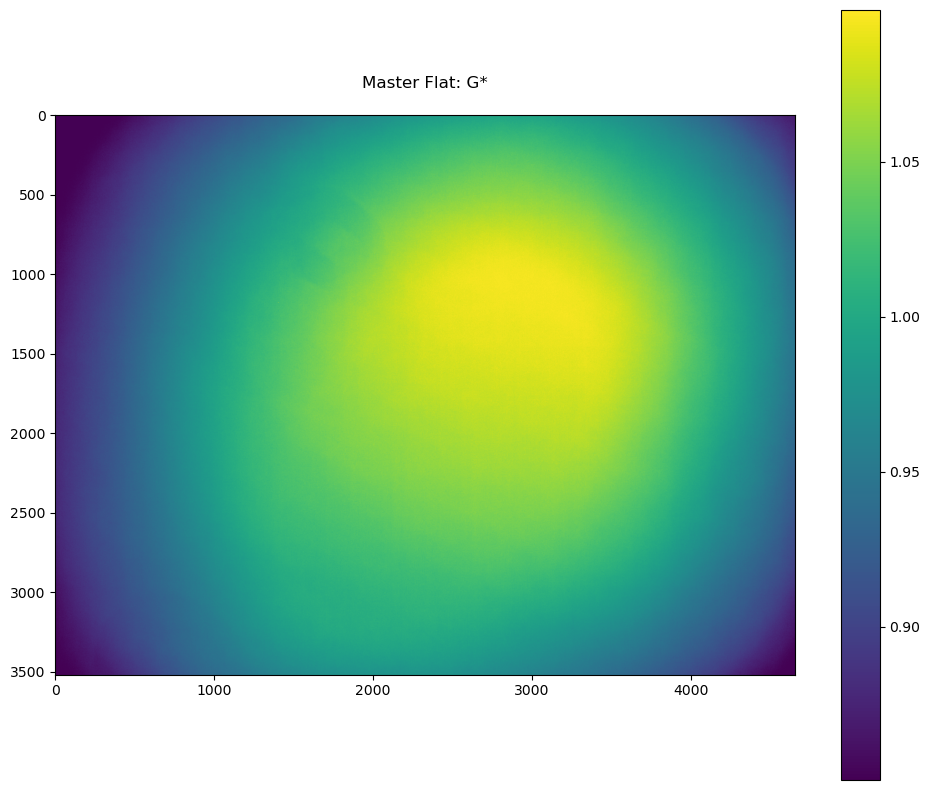

 40%|████      | 2/5 [00:11<00:17,  5.86s/it]

Computing master flat for Lum.


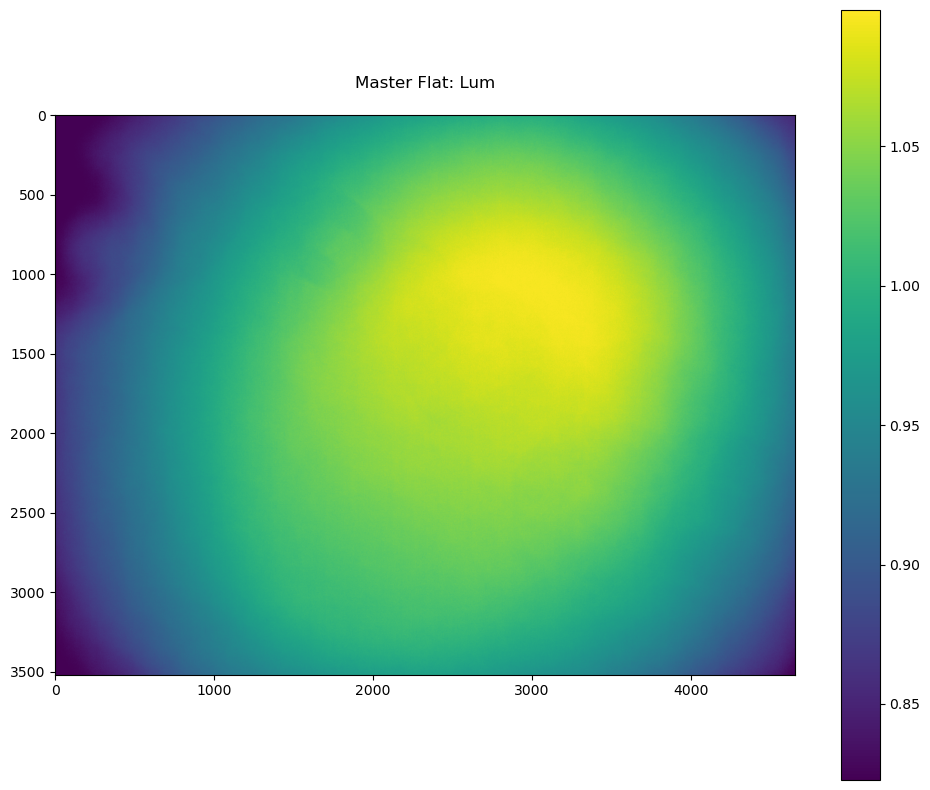

 60%|██████    | 3/5 [00:17<00:11,  5.83s/it]

Computing master flat for R*.


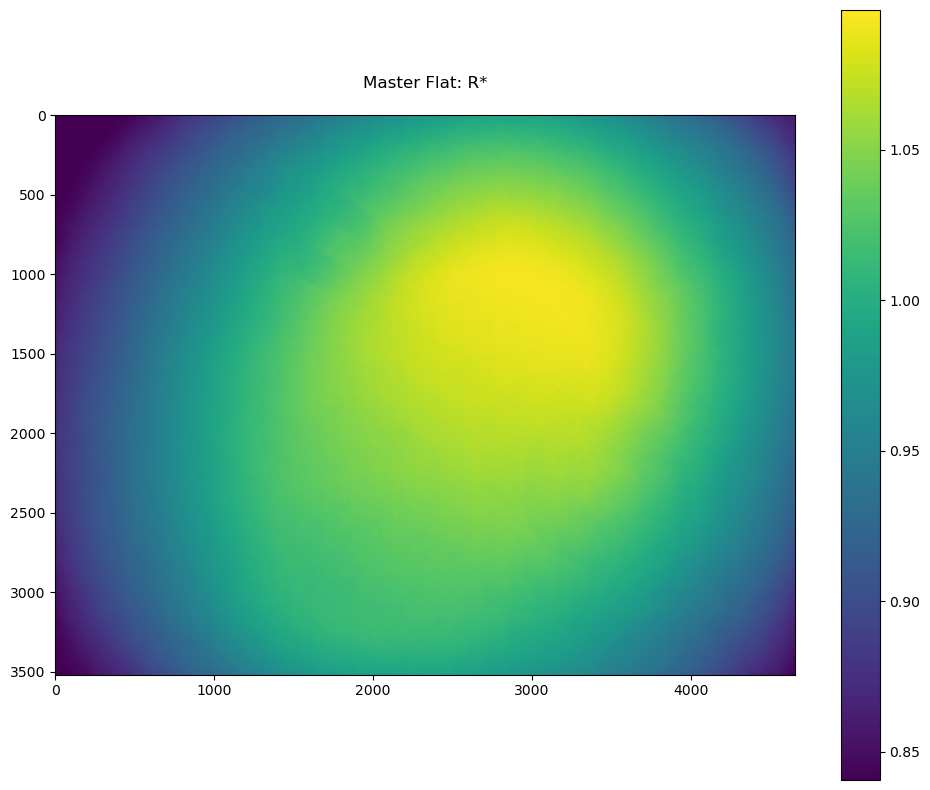

 80%|████████  | 4/5 [00:23<00:05,  5.79s/it]

Computing master flat for H_alpha.


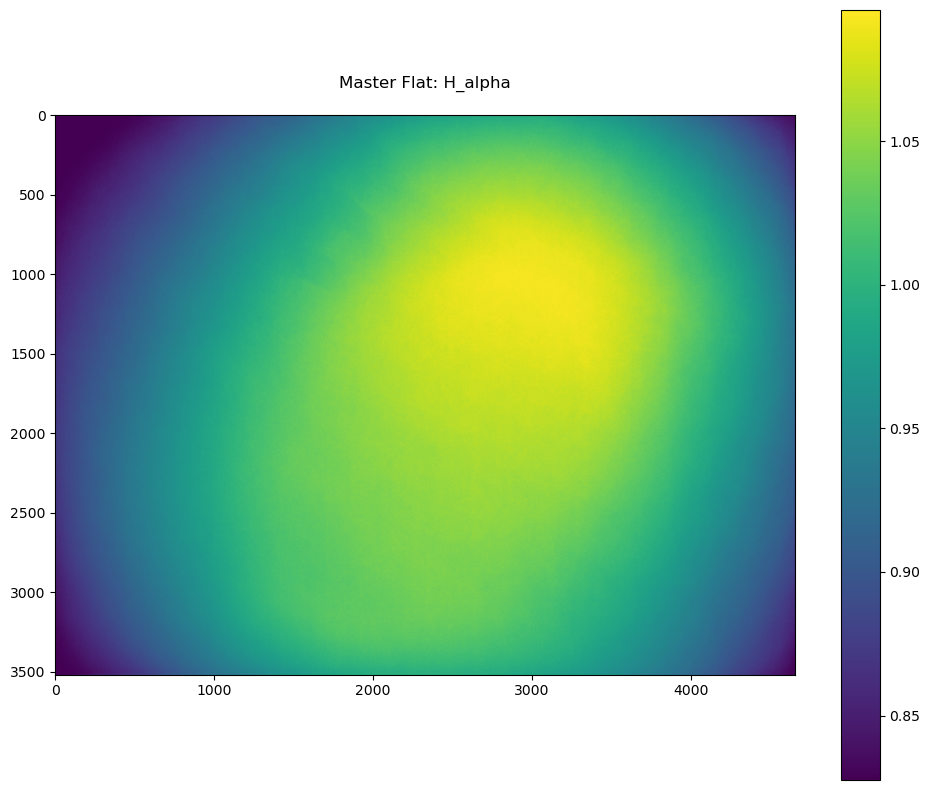

In [7]:
# Compute Master FLATS
import numpy as np

# Load
flat_files = file_df[file_df["IMAGETYP"] == 'FLAT']
master_bias = fits.getdata(os.path.join(data_dir, 'master_bias.fits'))
master_dark = fits.getdata(os.path.join(data_dir, 'master_dark.fits'))
exptime = flat_files['EXPTIME'].iloc[0]

header = fits.getheader(flat_files['FILEPATH'].iloc[0])
header['IMAGETYP'] = 'MASTER_FLAT'

header['COMBINED'] = 'MEDIAN'
header['COMMENT'] = 'Master flat frame created from normalized flat exposures'

flat_rows = []
# Compute
for fil in tqdm(flat_files['FILTER'].unique(), leave=False):    
    print(f"Computing master flat for {fil}.")
    
    flat_data = load_data(flat_files[flat_files['FILTER'] == fil]['FILEPATH'])
    subtracted_data = flat_data - master_bias[..., np.newaxis] # Omitted darks
    normalized_data = subtracted_data / np.median(subtracted_data, axis=(0,1)) 
    final_img = np.median(normalized_data, axis = -1)

    header['NFRAMES'] = len(flat_data)
    header['FILTER'] = fil 
    
    plot_image(final_img, f"Master Flat: {fil}")
    
    # Save
    fp = os.path.join(data_dir, f'master_flat_{fil}.fits')
    
    write_fits(fp, final_img, header, overwrite=True)
    
    if fn not in file_df['FILENAME']: # Prevent reruns from breaking the code
        flat_rows.append({'FILENAME' : f'master_flat_{fil}.fits', 'FILEPATH' : fp,
               'IMAGETYP' : 'MASTER_FLAT',
               'OBJECT' : None,
               'FILTER' :fil,
               'EXPTIME' :header.get('EXPTIME', None)})
file_df = pd.concat([file_df, pd.DataFrame(flat_rows)], ignore_index=True)

### Correct Images
We correct each of our images by subtracting the bias and dividing by the flat. As stated previously, we chose to omit dark correction for the reason that there seem to have been some issues with the darks causing massive negative values when correcting properly (following the steps from the sheet)

  0%|          | 0/128 [00:00<?, ?it/s]

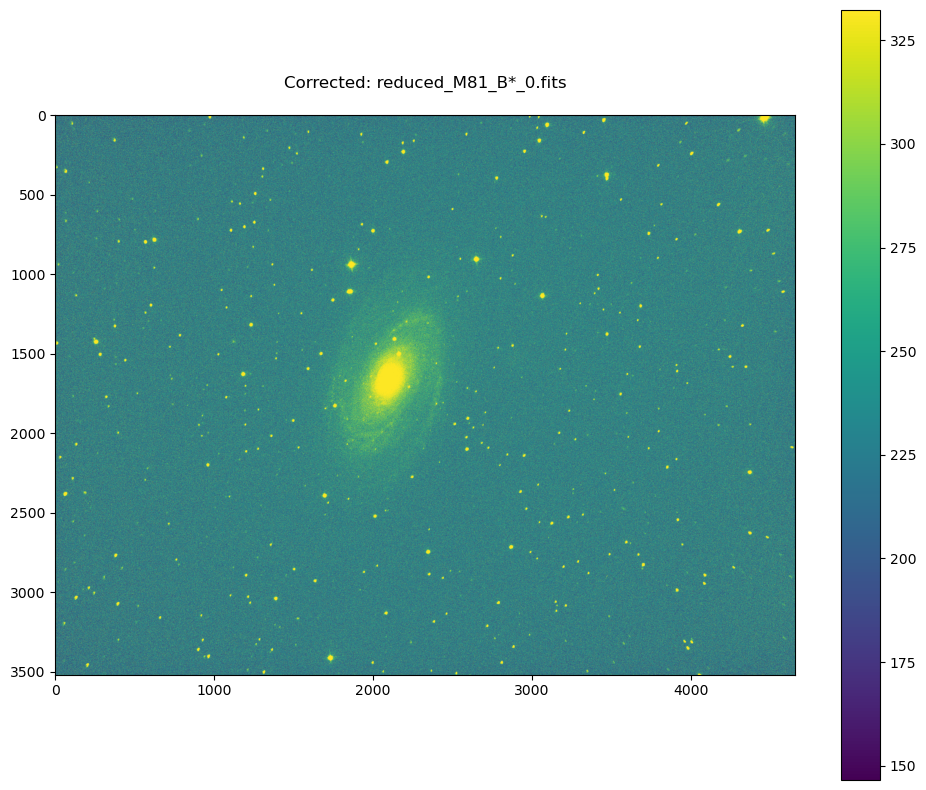

  5%|▍         | 6/128 [00:05<01:15,  1.61it/s]

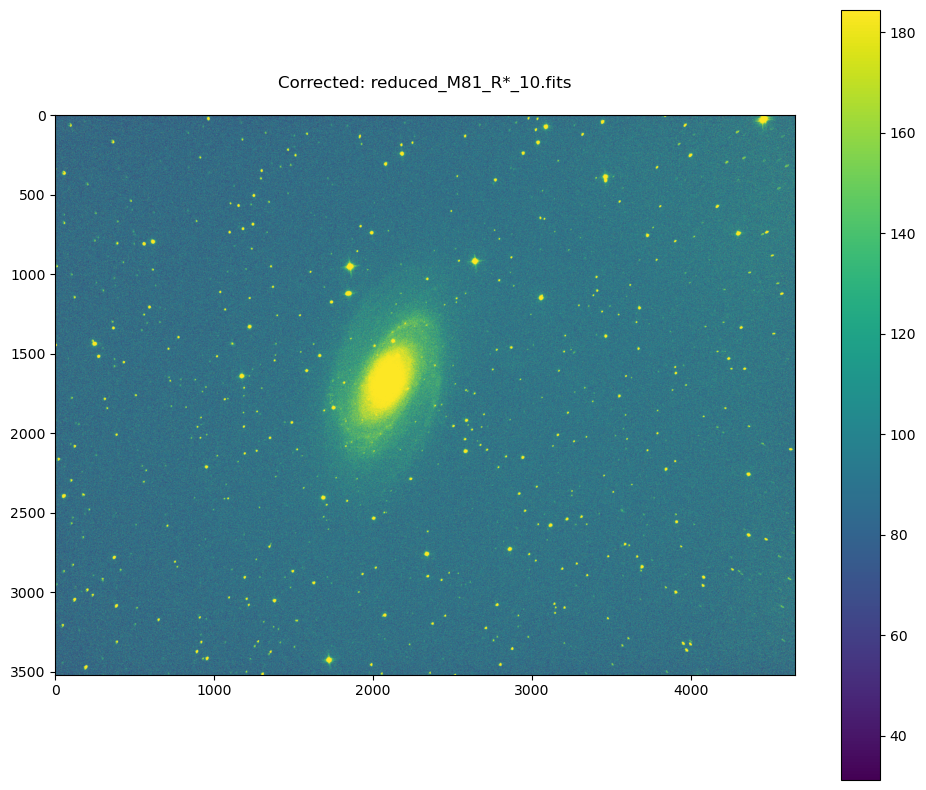

 12%|█▎        | 16/128 [00:11<00:48,  2.31it/s]

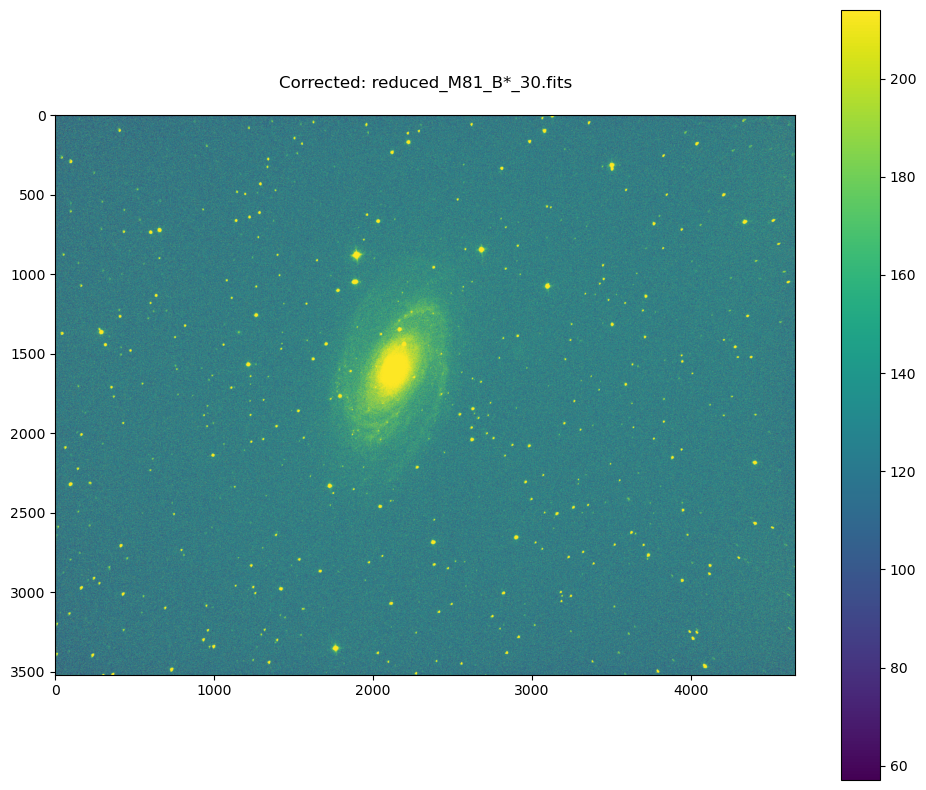

 17%|█▋        | 22/128 [00:17<00:56,  1.89it/s]

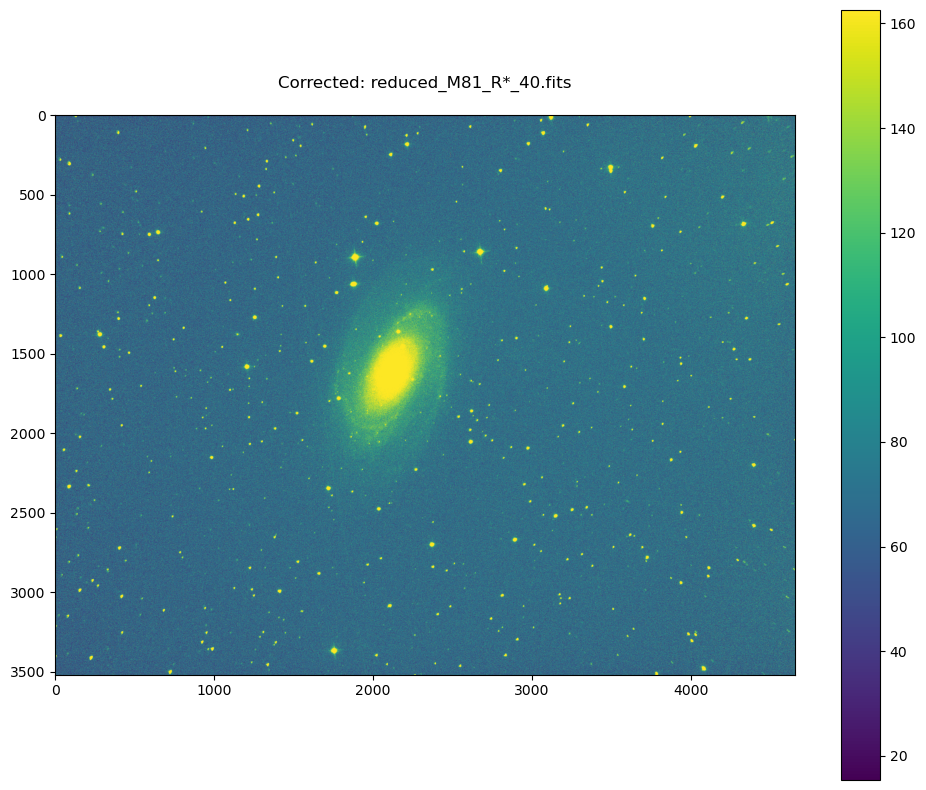

 36%|███▌      | 46/128 [00:30<00:33,  2.44it/s]

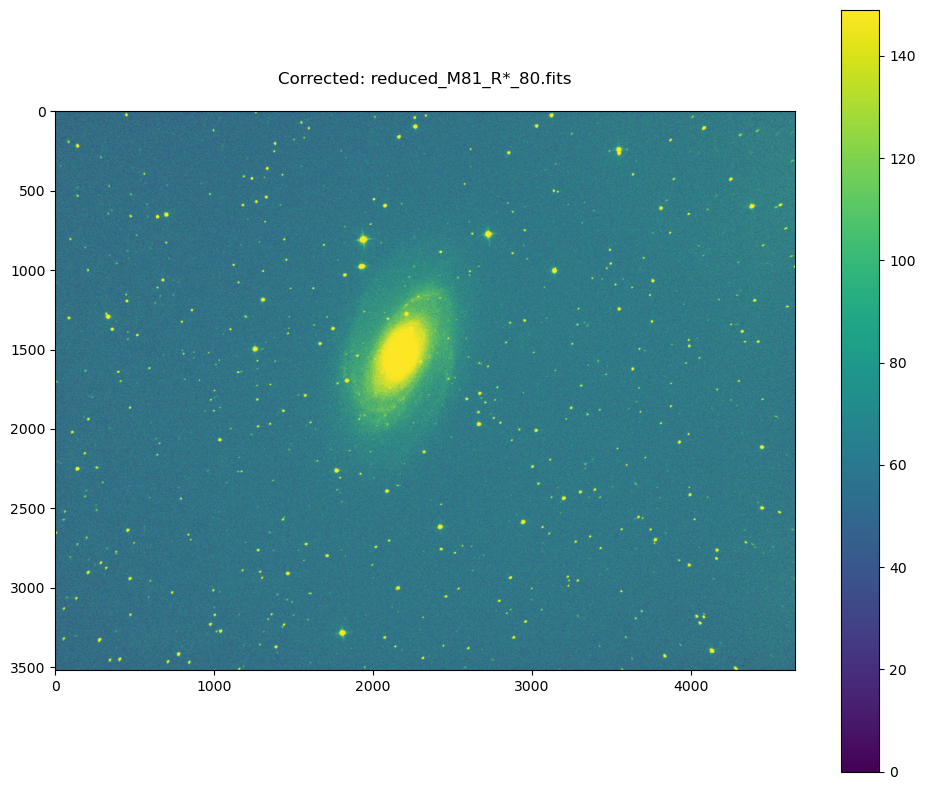

 43%|████▎     | 55/128 [00:36<00:31,  2.33it/s]

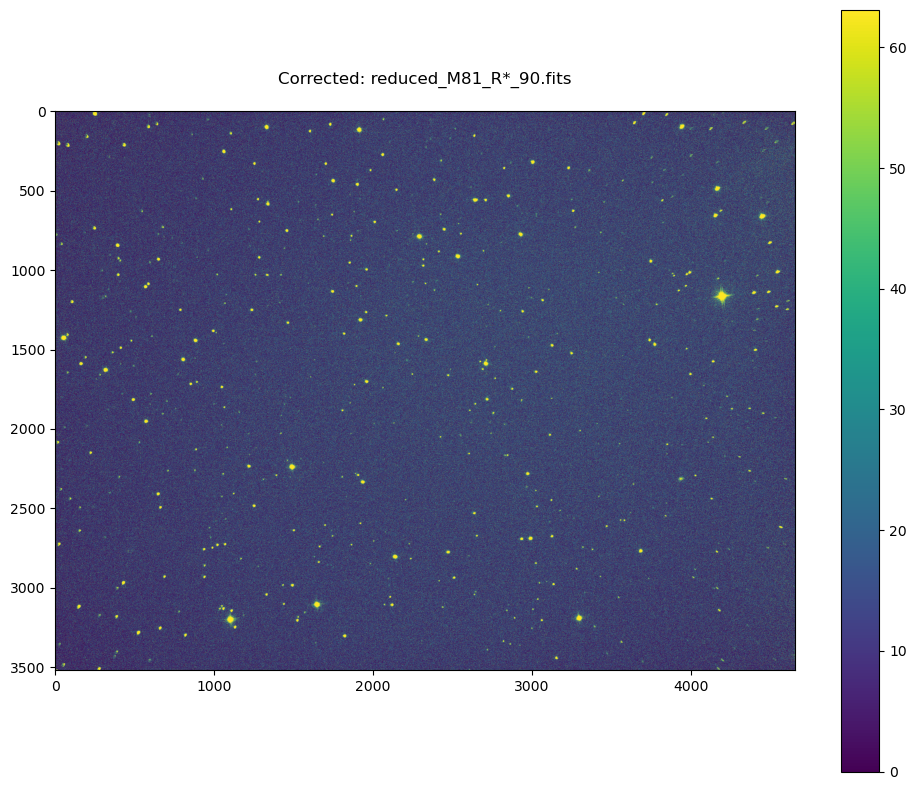

 50%|█████     | 64/128 [00:42<00:26,  2.37it/s]

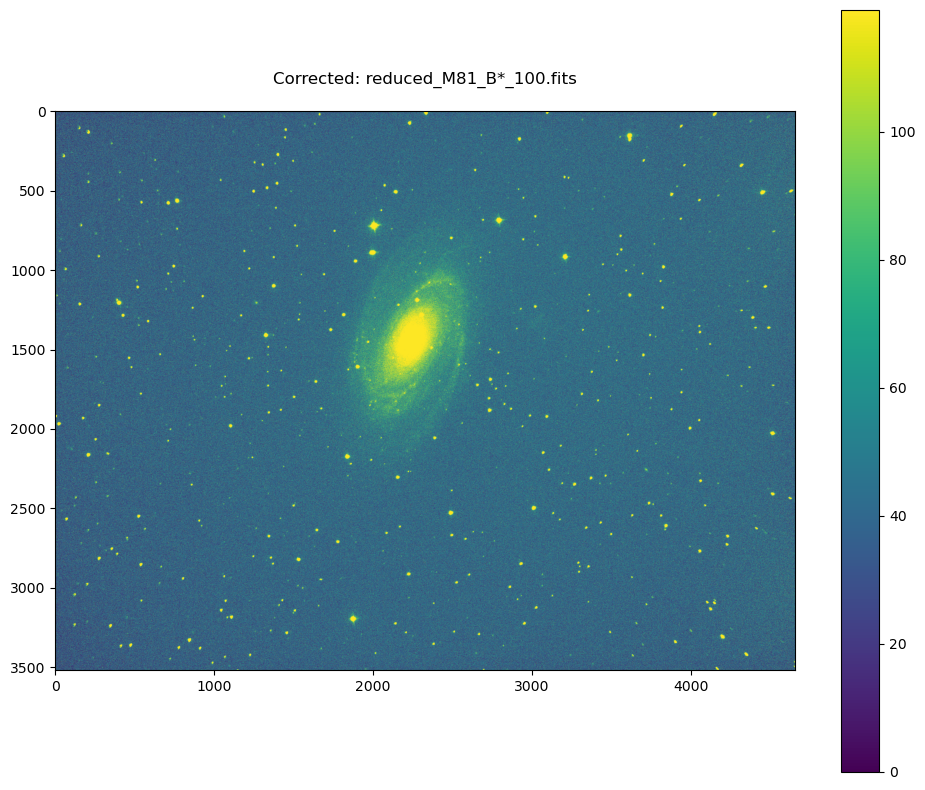

 57%|█████▋    | 73/128 [00:48<00:23,  2.33it/s]

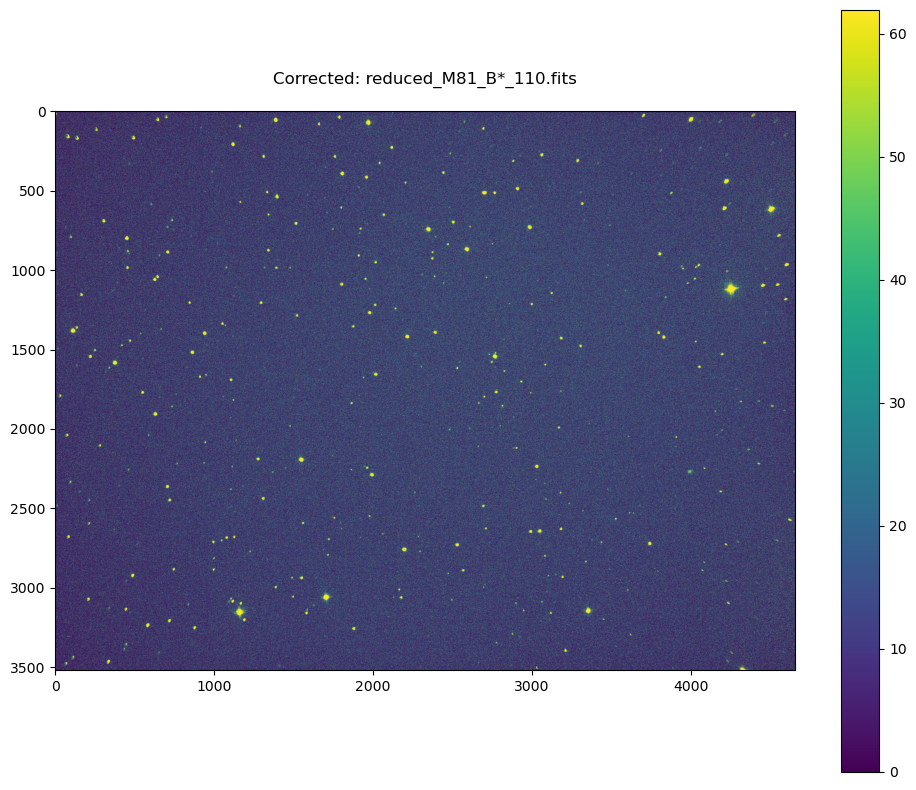

 70%|███████   | 90/128 [00:57<00:14,  2.57it/s]

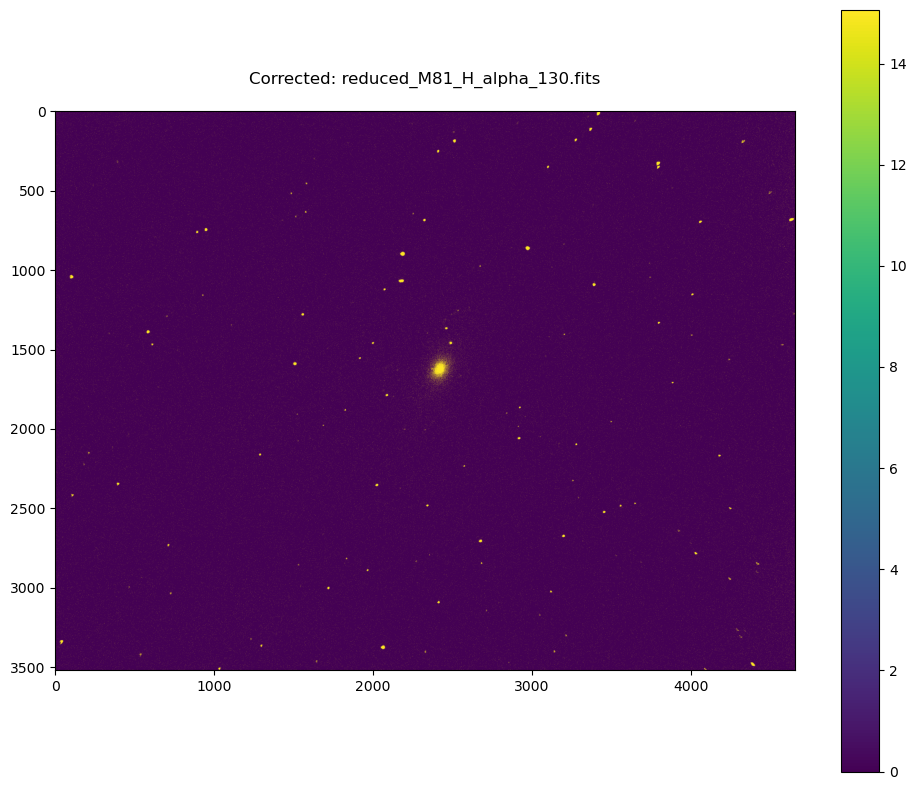

 77%|███████▋  | 99/128 [01:03<00:12,  2.40it/s]

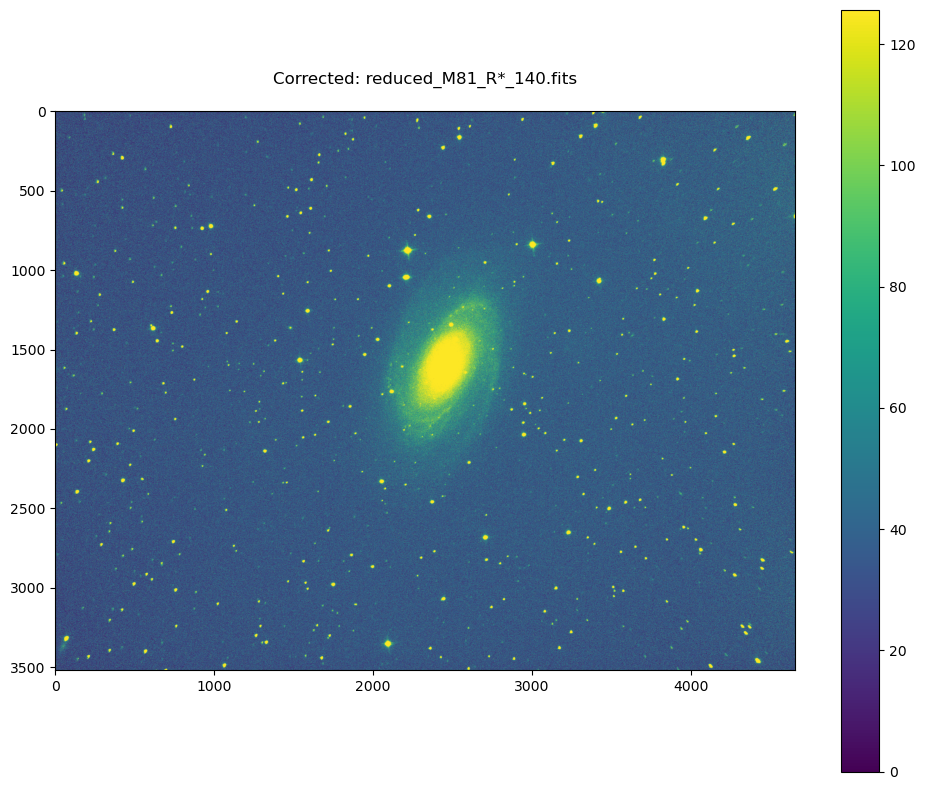

 85%|████████▌ | 109/128 [01:09<00:07,  2.40it/s]

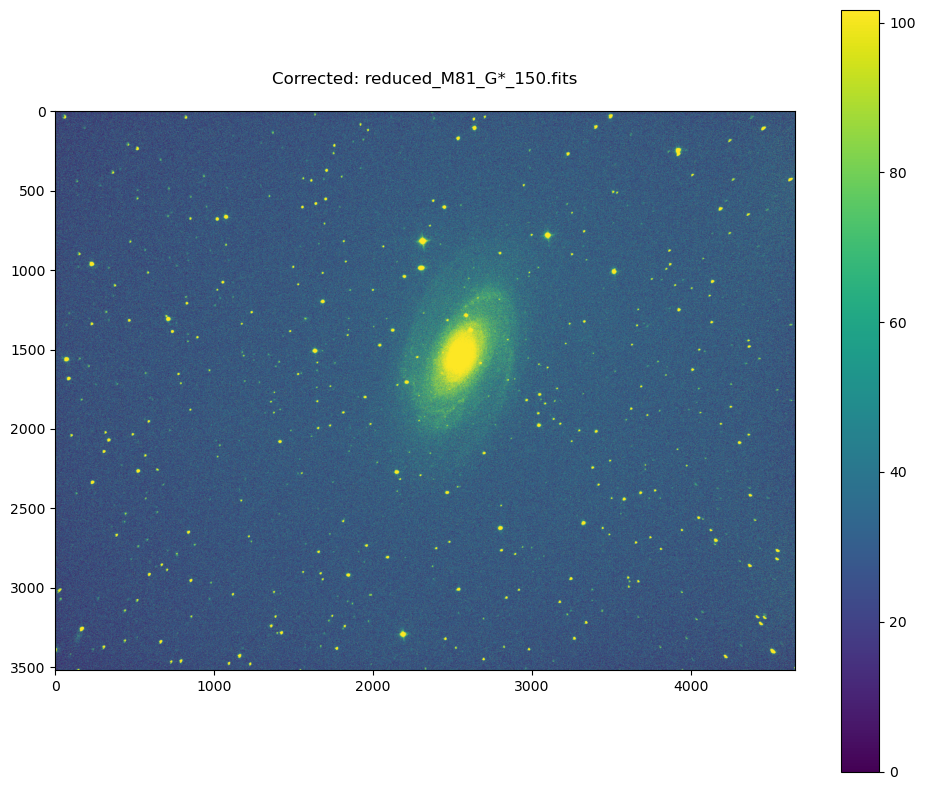

 93%|█████████▎| 119/128 [01:17<00:04,  1.99it/s]

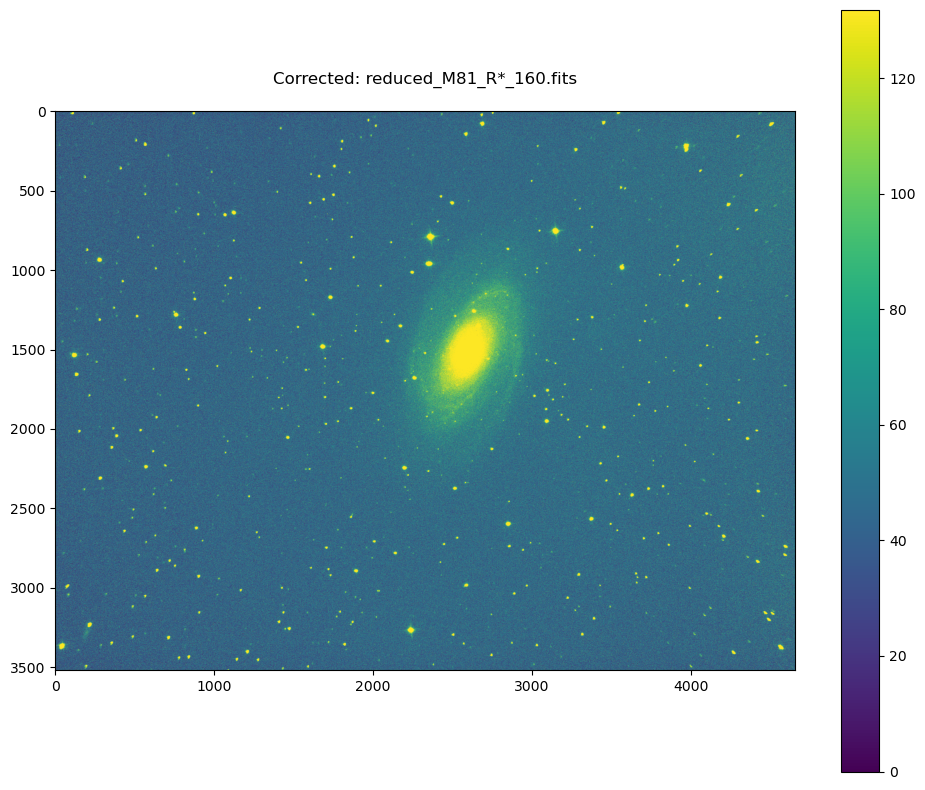

100%|██████████| 128/128 [01:23<00:00,  1.54it/s]


In [8]:
flat_files = file_df[file_df["IMAGETYP"] == 'MASTER_FLAT']

# Construct a dictionary mapping fil : flat
flat_dict = {fil : fits.getdata(flat_files[flat_files['FILTER'] == fil].iloc[0]['FILEPATH'])
             for fil in flat_files['FILTER'].unique()}

master_bias = fits.getdata(os.path.join(data_dir, 'master_bias.fits'))
master_dark = fits.getdata(os.path.join(data_dir, 'master_dark.fits'))

img_files = file_df[(file_df["IMAGETYP"] == 'LIGHT') &
                    (file_df['FILTER'] != 'ND1.2') & (file_df['FILTER'] != None)]

corrected_rows = []
for idx, row in tqdm(img_files.iterrows(), total=len(img_files)):
    fp = row["FILEPATH"]
    name = fp.split('_')[-1][:-4]
    
    data = fits.getdata(fp)
    
    fil = row["FILTER"]
    
    # Correct image
    
    corrected = (data - master_bias) / flat_dict[fil] # Omitted dark correction of - master_dark * row['EXPTIME']
    
    header = fits.getheader(fp)
    header['COMMENT'] = 'Reduced frame created from master_bias and master_flat'
    header['IMAGETYP'] = 'REDUCED'
    header['OBJECT'] = row['OBJECT']
    
    fn = f'reduced_{obj}_{fil}_{idx}.fits'
    fp_new = os.path.join(data_dir, fn)
                            
    write_fits(fp_new, corrected, header, overwrite=True)
    
    if fn not in file_df['FILENAME']: # Prevent reruns from breaking the code
        corrected_rows.append({'FILENAME' : fn, 'FILEPATH' : fp_new,
           'IMAGETYP' : 'REDUCED',
            'OBJECT' : row['OBJECT'],
           'FILTER' : fil,
           'EXPTIME' :header.get('EXPTIME', None)})
    
    if idx % 10 == 0:
        plot_image(corrected, f"Corrected: {fn}")

file_df = pd.concat([file_df, pd.DataFrame(corrected_rows)], ignore_index=True)                          

### Register

Now we need to register the images. This entails picking a reference for each band and object and aligning the other images such that all objects are at the same coordinates in all images. This is done using astroalign. We are careful to not let the process result in an error as this step can take quite some time.

 10%|█         | 26/256 [00:44<09:18,  2.43s/it]

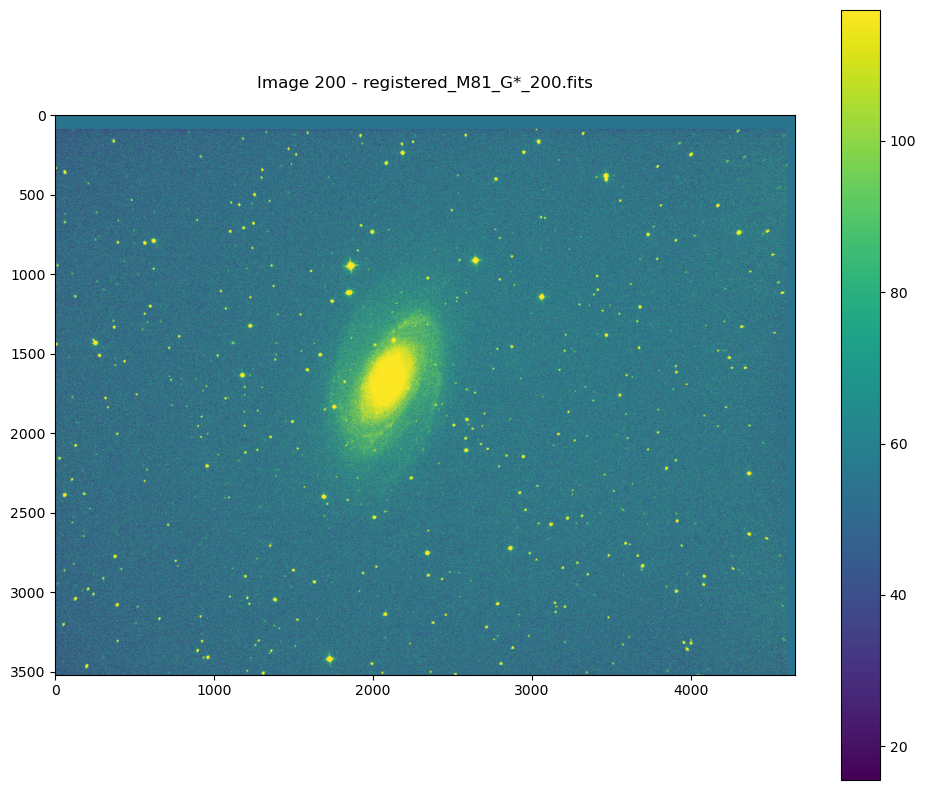

 18%|█▊        | 46/256 [01:35<08:26,  2.41s/it]

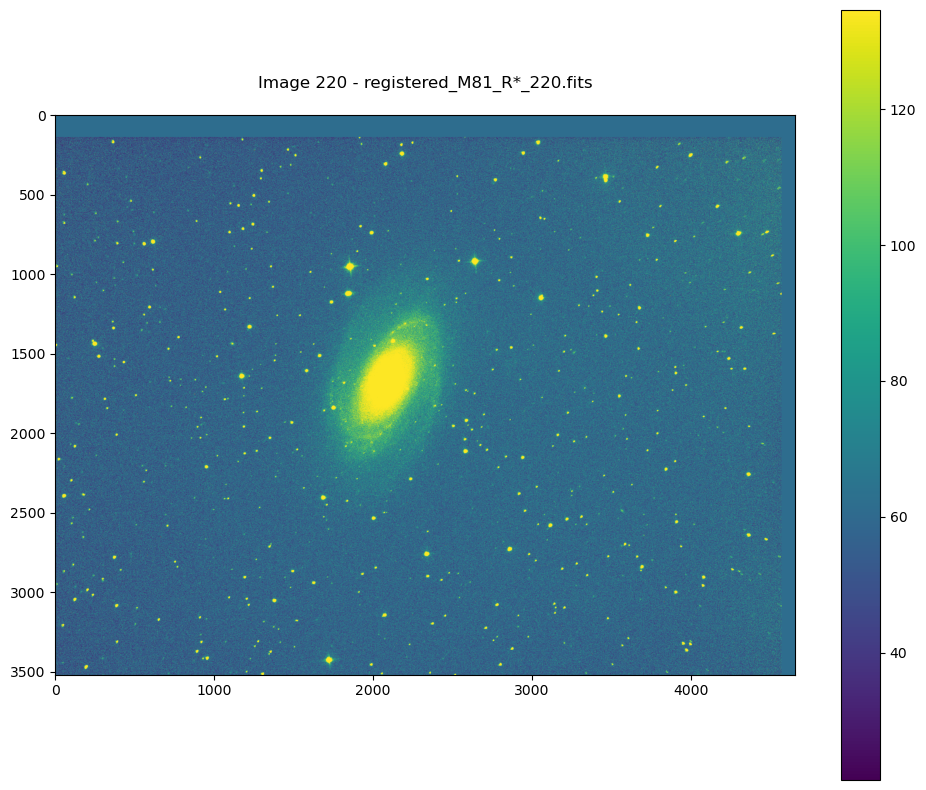

 26%|██▌       | 66/256 [02:28<07:58,  2.52s/it]

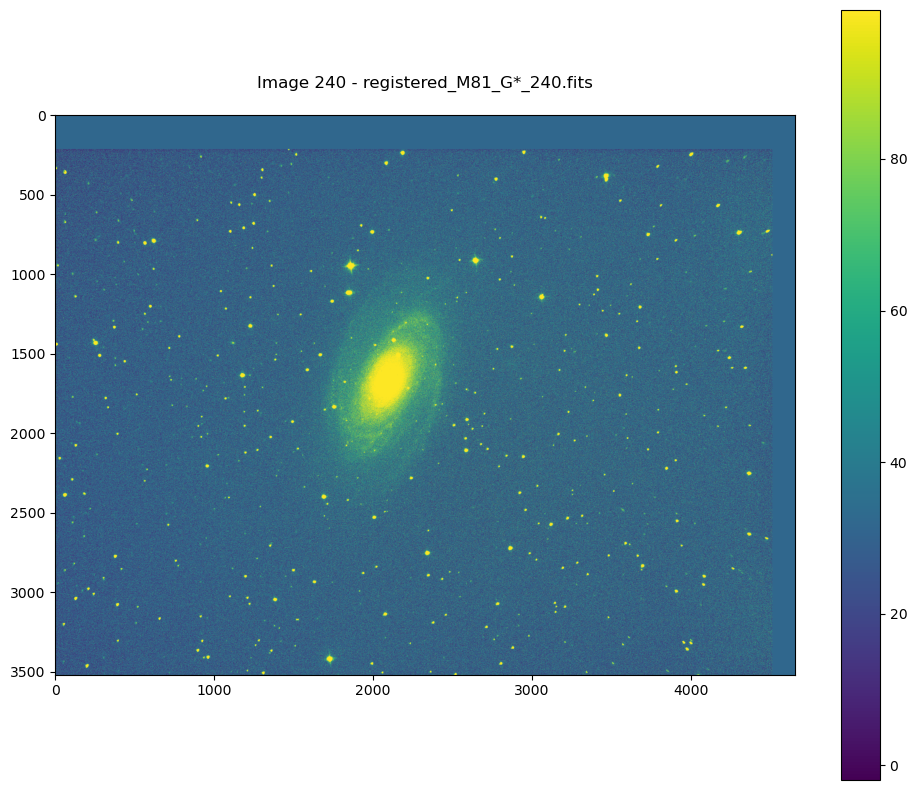

 34%|███▎      | 86/256 [03:21<07:16,  2.57s/it]

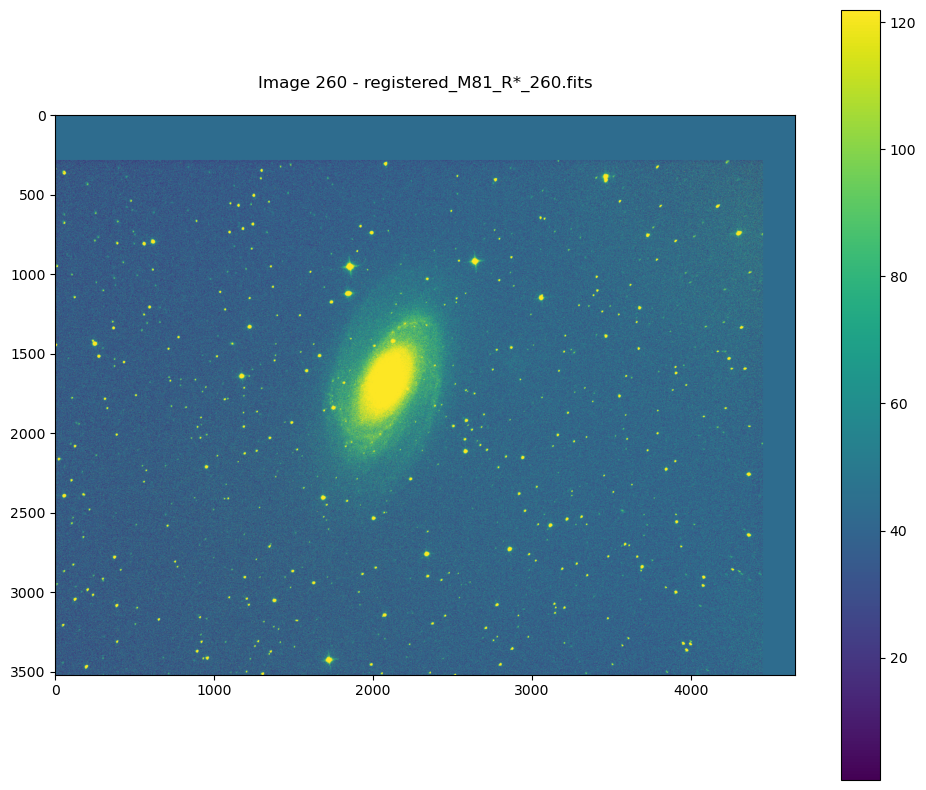

 41%|████▏     | 106/256 [04:17<06:29,  2.59s/it]

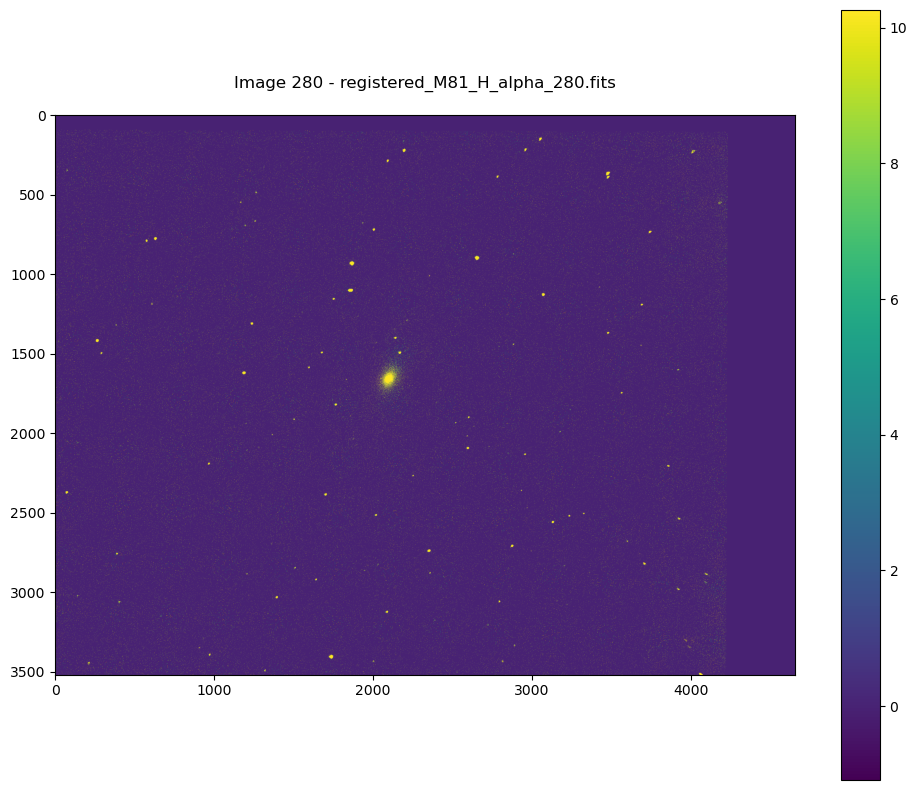

 49%|████▉     | 126/256 [05:13<05:53,  2.72s/it]

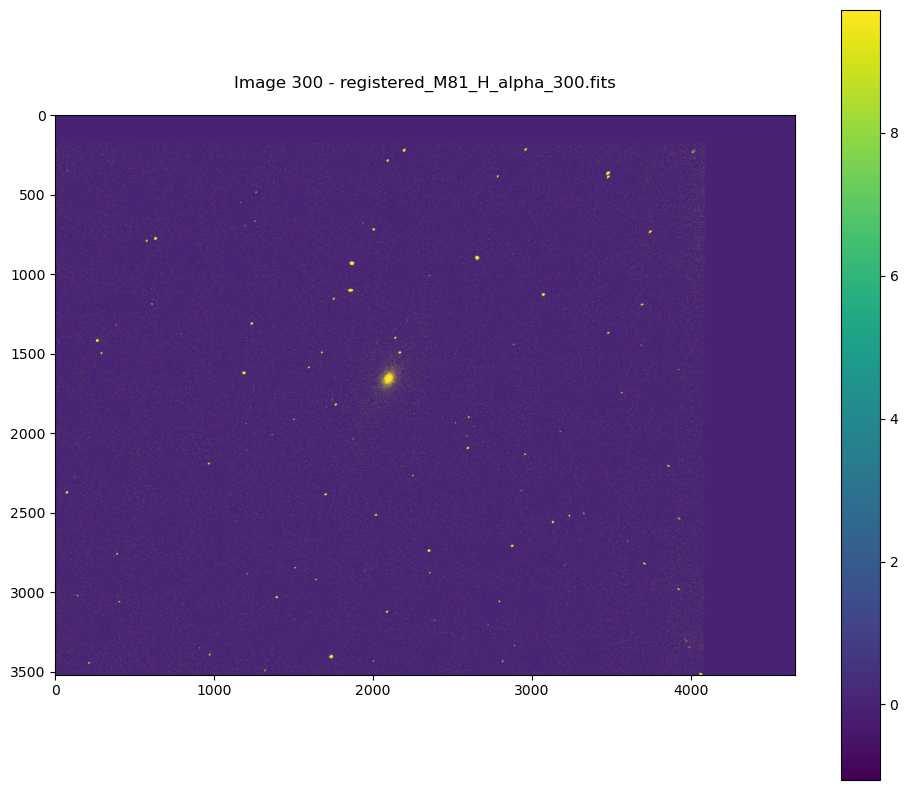

 55%|█████▌    | 141/256 [05:54<04:39,  2.43s/it]

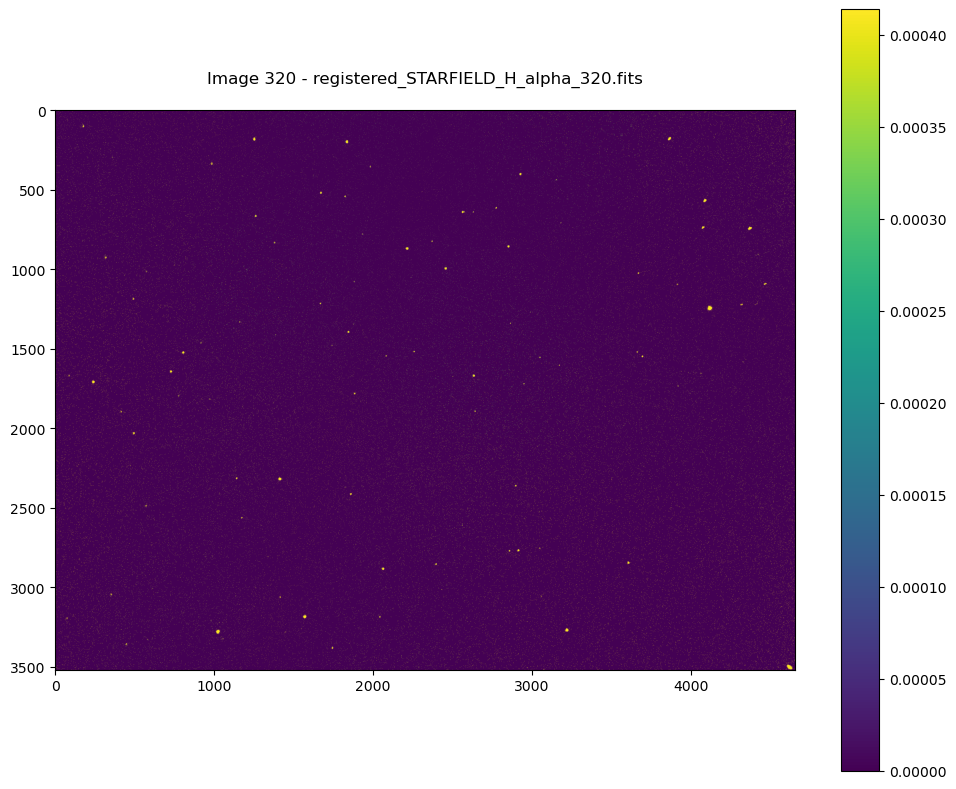

 63%|██████▎   | 161/256 [06:44<03:46,  2.38s/it]

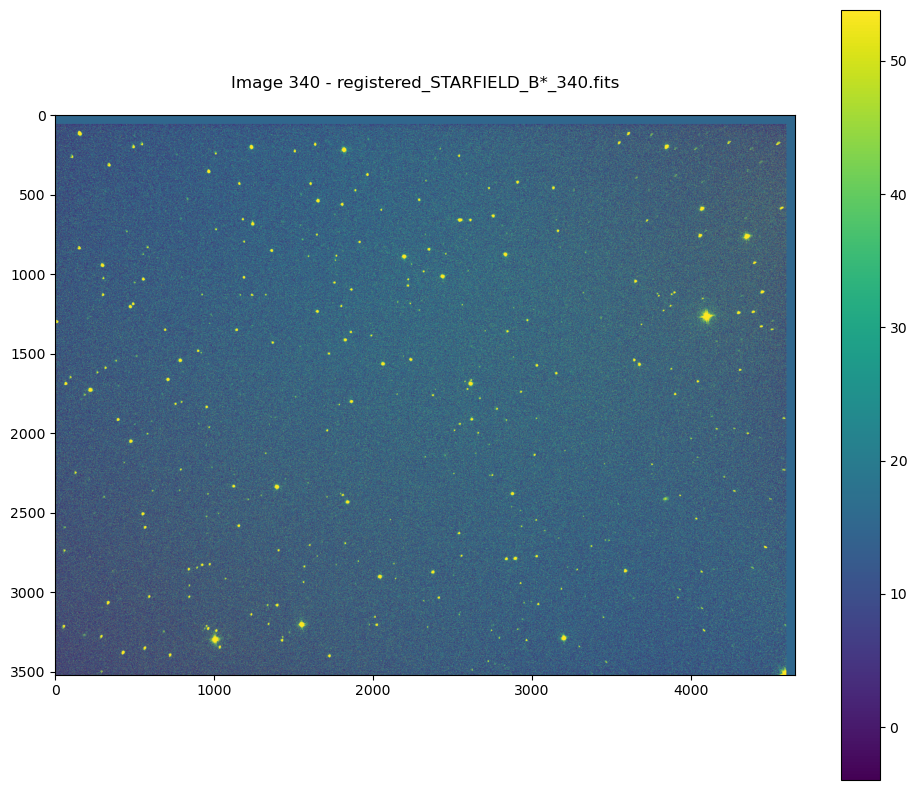

 71%|███████   | 181/256 [07:34<02:56,  2.35s/it]

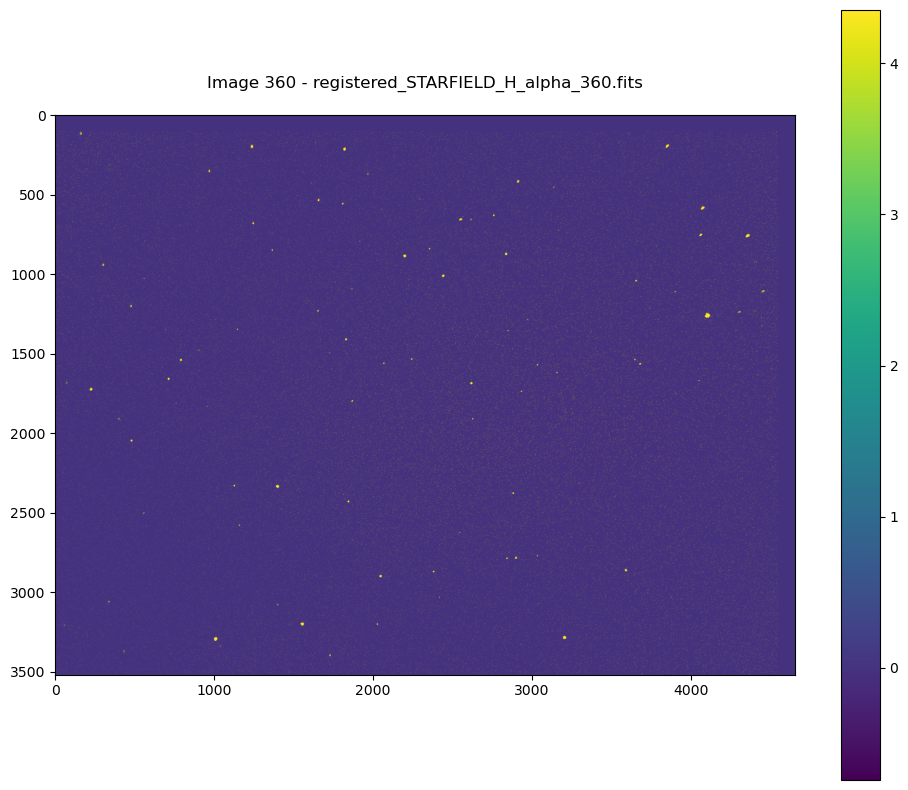

 79%|███████▊  | 201/256 [08:25<02:12,  2.40s/it]

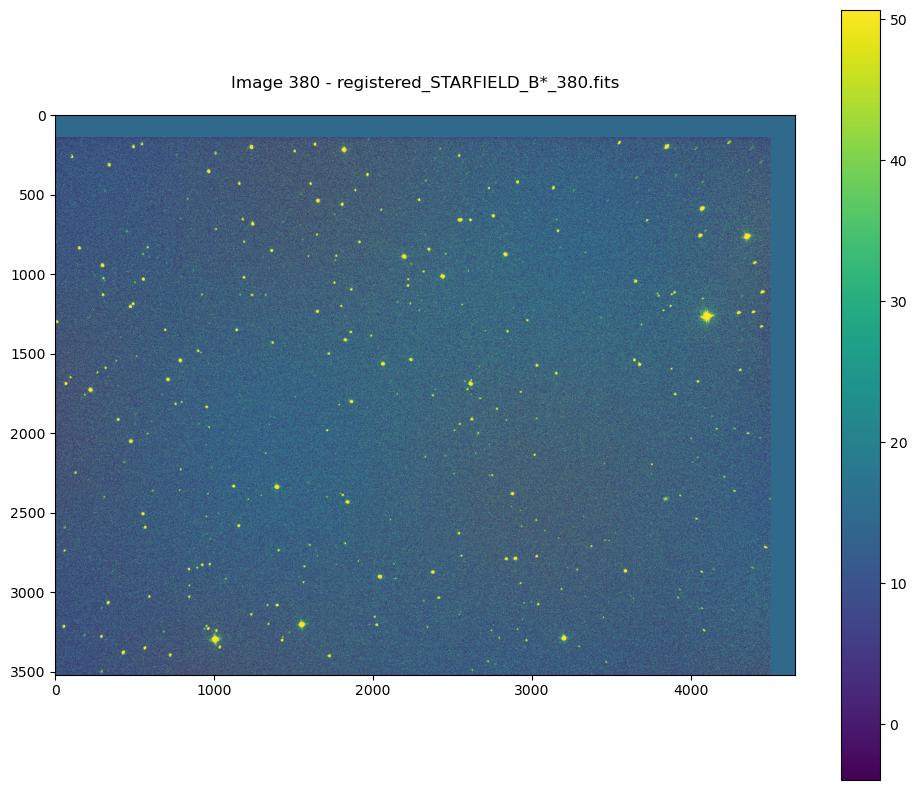

 86%|████████▋ | 221/256 [09:16<01:23,  2.38s/it]

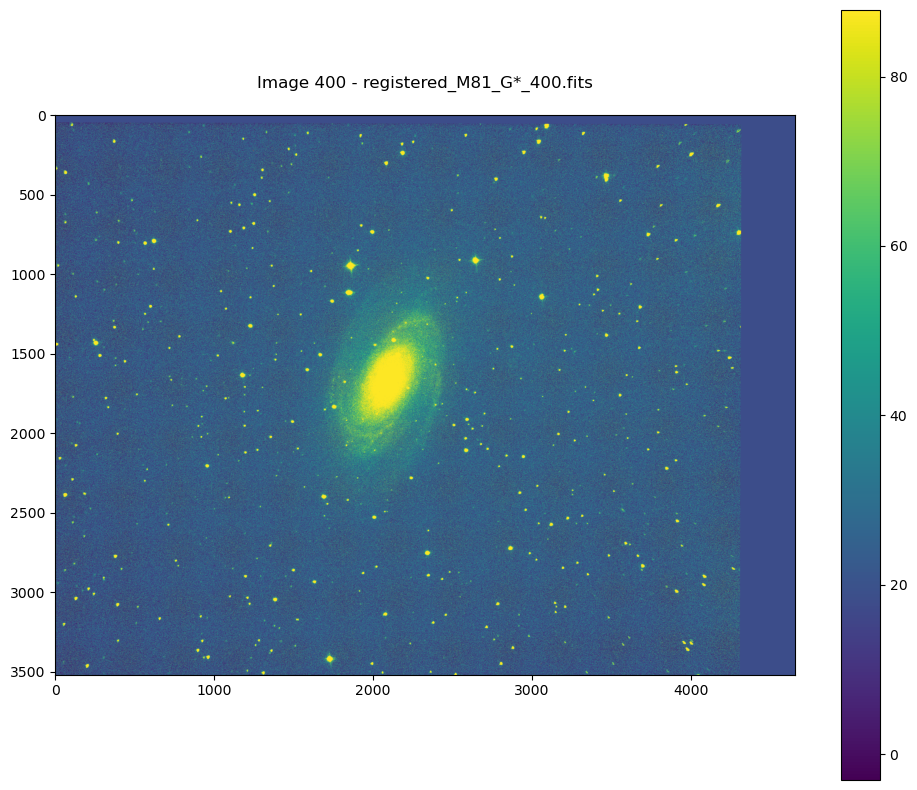

 94%|█████████▍| 241/256 [10:11<00:39,  2.65s/it]

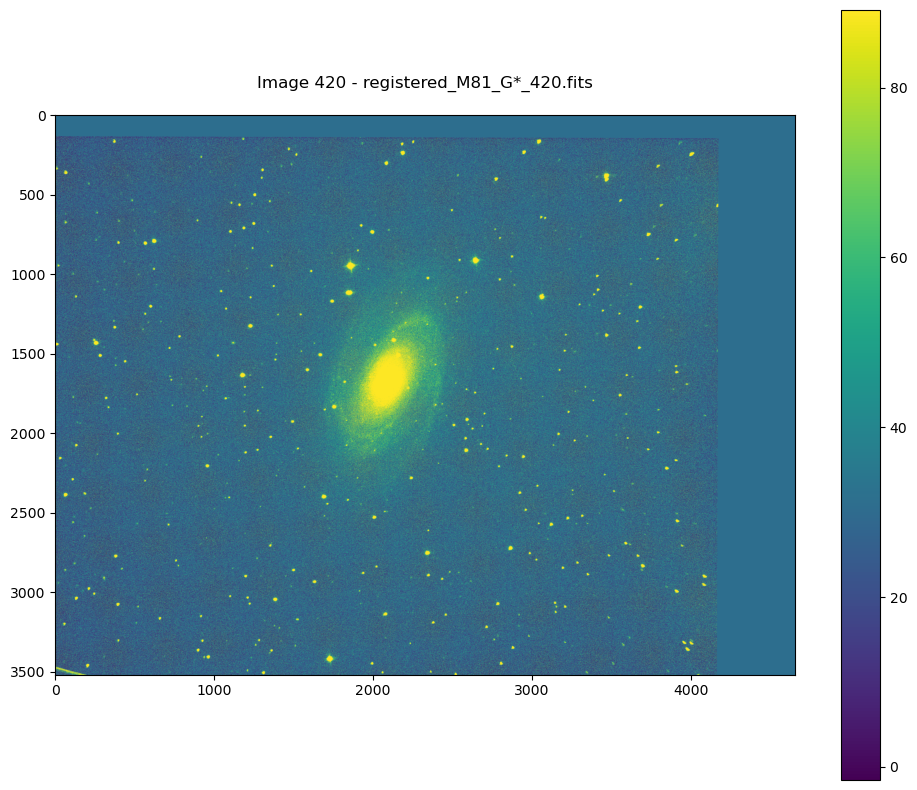

100%|██████████| 256/256 [10:55<00:00,  2.56s/it]


In [9]:
reduced_files = file_df[file_df["IMAGETYP"] == 'REDUCED']


targets = {}

registered_rows = []

for idx, row in tqdm(reduced_files.iterrows(), total=len(reduced_files)):
    fp = row["FILEPATH"]

    # Load data
    data = fits.getdata(fp)
    data = data.byteswap().newbyteorder()
    
    header = fits.getheader(fp)
    key = f"{header['OBJECT']}_{header['FILTER']}"
    
    # The first image of every kind is used as a reference
    if key not in targets.keys():
        targets[key] = data
        continue
    
    # Convert bytes and register img
    ref_data = targets[key].byteswap().newbyteorder()  
    try:
        registered, _ = aa.register(data, ref_data)
    except (aa.MaxIterError, ValueError):
        print(f"No fit found for {header['OBJECT']} {header['FILTER']} idx={idx} at {fp}")
        
        continue
   
    # Save result
    header = fits.getheader(fp)
    header['IMAGETYP'] = 'REGISTERED'
    fn = f'registered_{key}_{idx}.fits'
    write_fits(os.path.join(data_dir, fn), registered, header, overwrite=True)
    
    if idx % 20 == 0:
        plot_image(registered, f"Image {idx} - {fn}")
        
    if fn not in file_df['FILENAME']: # Prevent reruns from breaking the code
        registered_rows.append({'FILENAME' : fn, 'FILEPATH' : os.path.join(data_dir, fn),
           'IMAGETYP' : 'REGISTERED',
            'OBJECT' : row['OBJECT'],
           'FILTER' : row['FILTER'],
           'EXPTIME' :header.get('EXPTIME', None)})
    
file_df = pd.concat([file_df, pd.DataFrame(registered_rows)], ignore_index=True) 


### Combine Images and Sky Background Subtraction

After aligning all the images, we can now combine them into one image per band and object pair. This is done by taking the median. Additionally, we have not yet corrected for the background level of the sky. This is done using the ModeEstimatorbackground. This class estimates the background value using the mode, this value is then subtracted from the image.

0it [00:00, ?it/s]

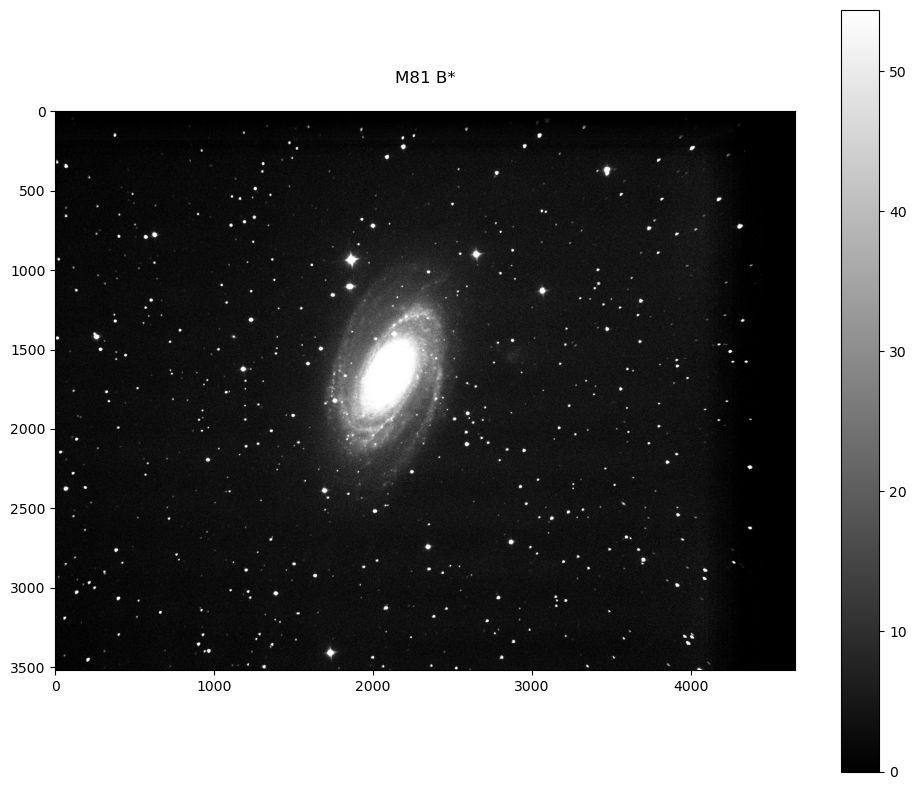

1it [00:20, 20.80s/it]

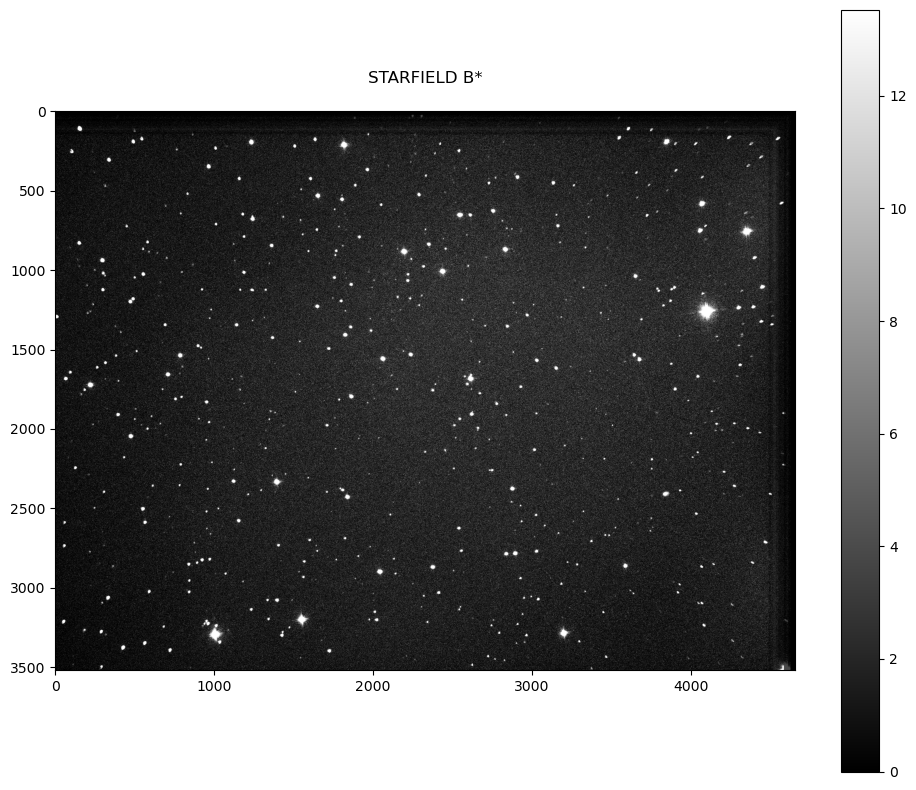

2it [00:35, 16.93s/it]

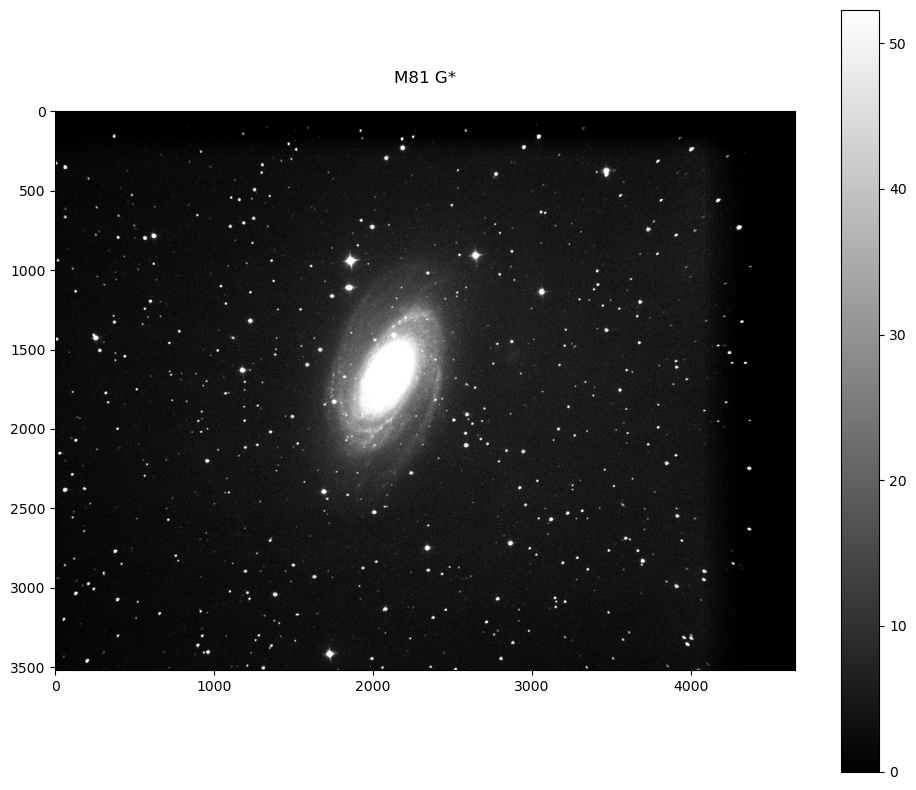

3it [00:56, 19.15s/it]

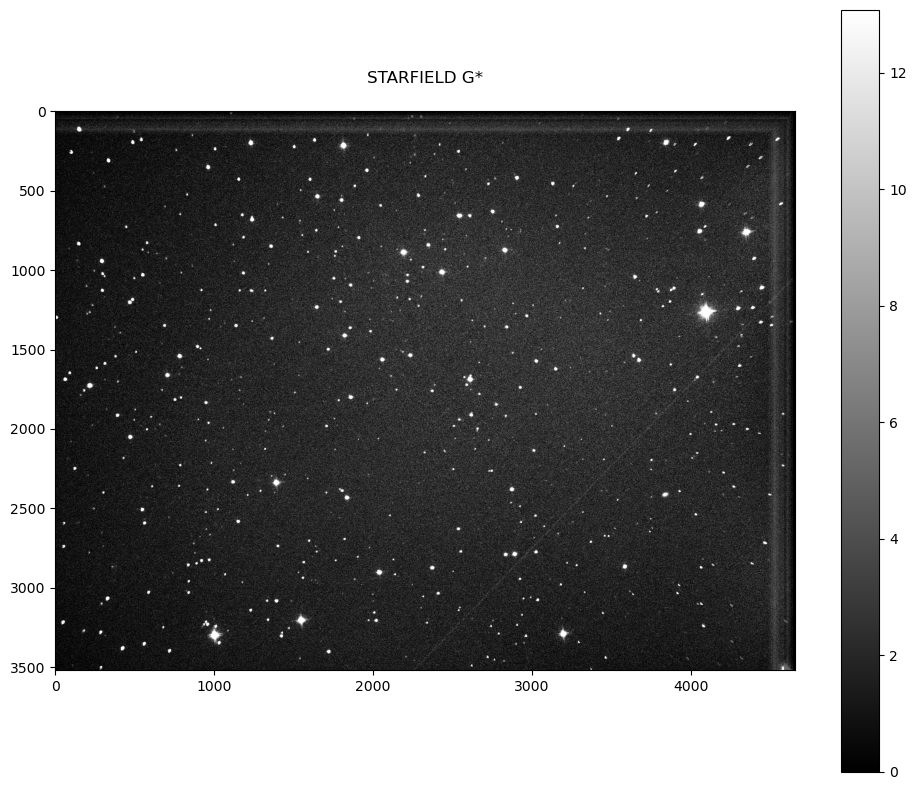

4it [01:10, 16.98s/it]

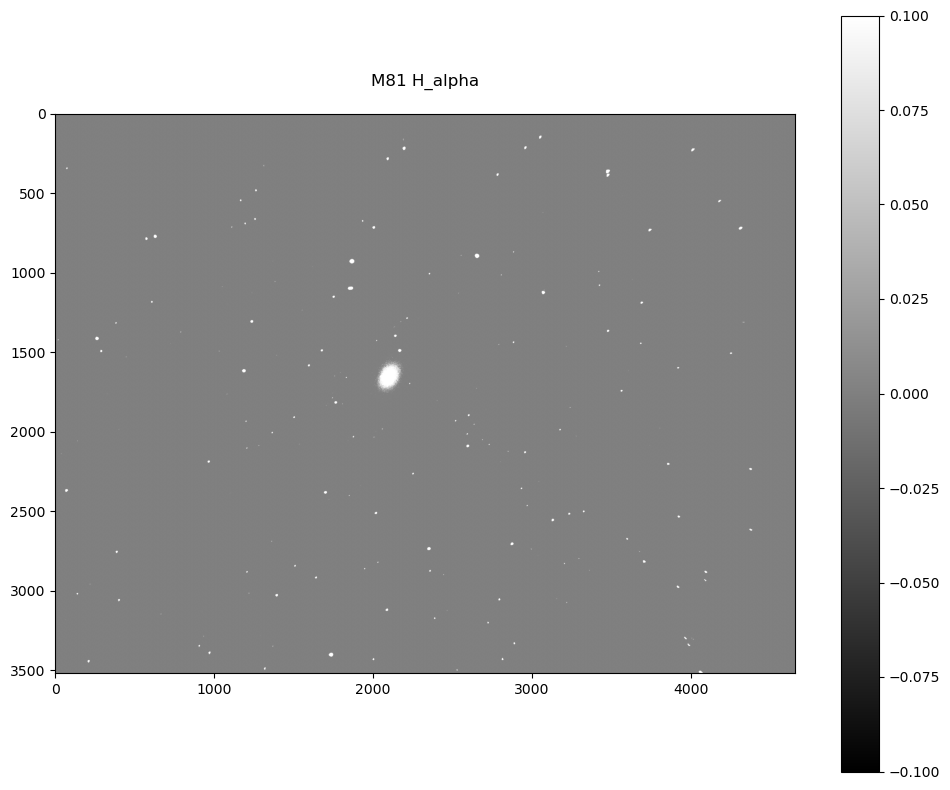

5it [01:24, 16.08s/it]

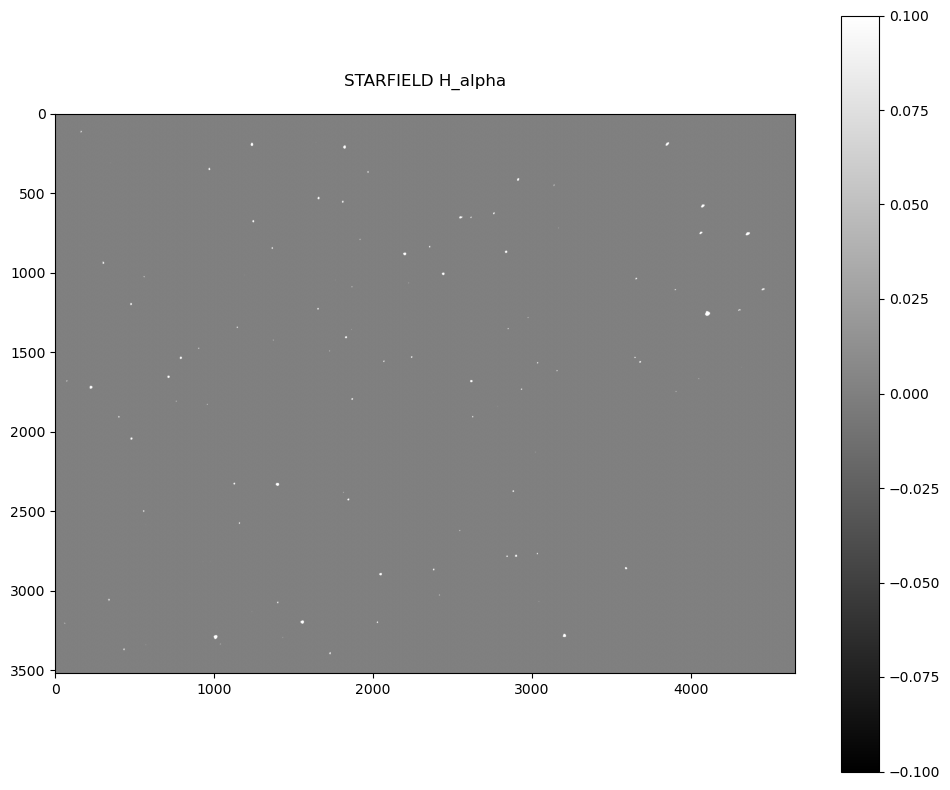

6it [01:33, 13.64s/it]

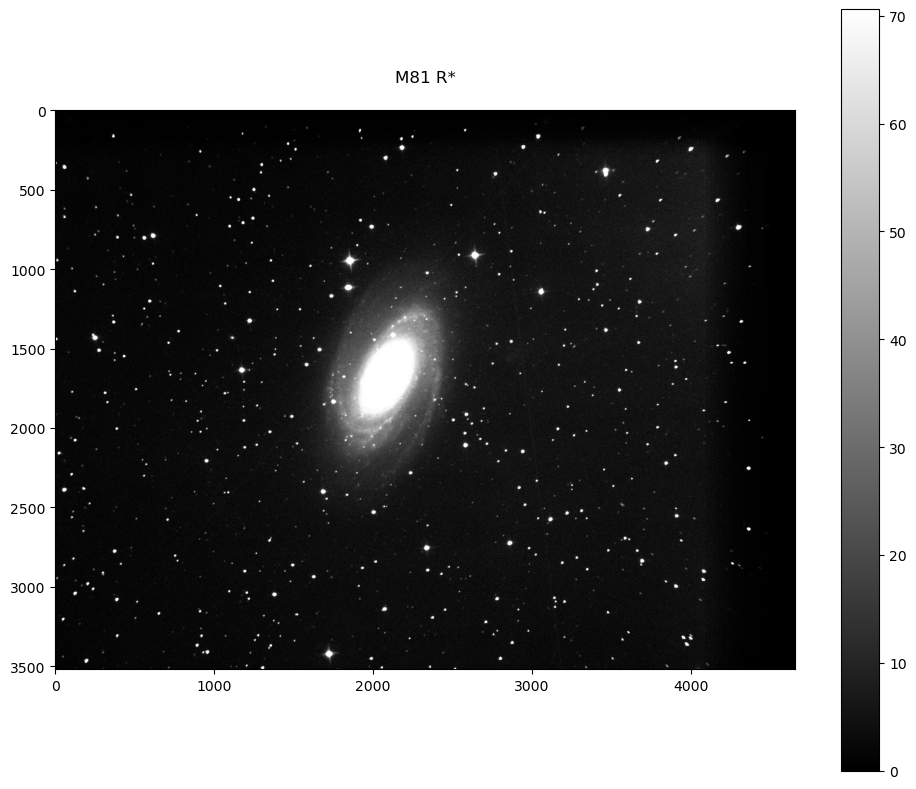

7it [01:56, 16.43s/it]

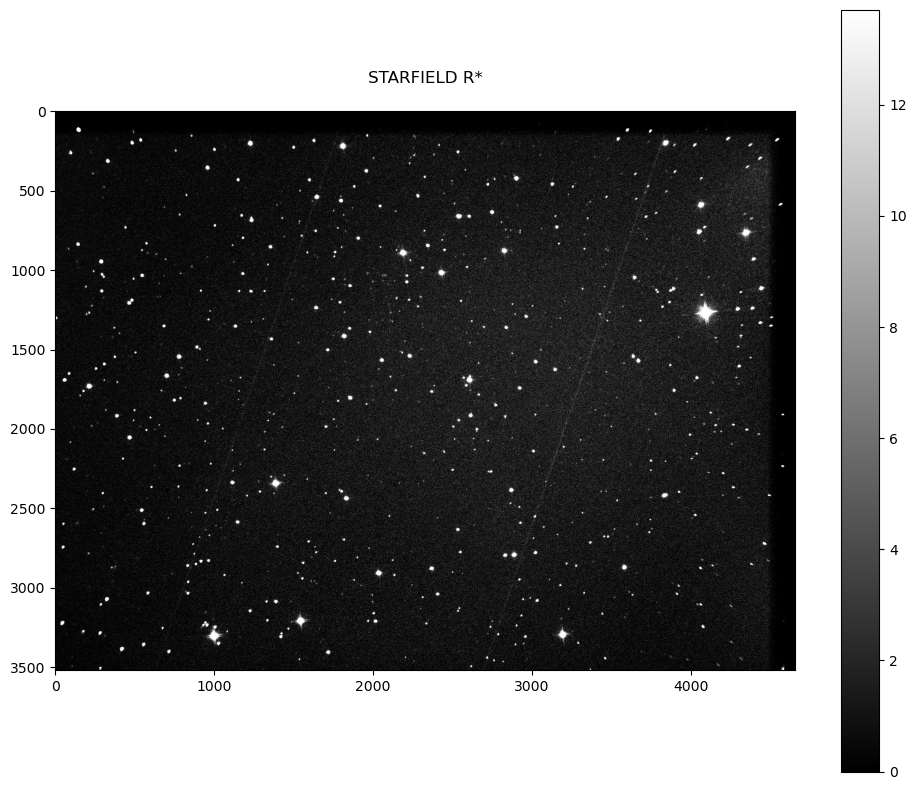

8it [02:09, 16.23s/it]


In [10]:
registered_files = file_df[file_df["IMAGETYP"] == 'REGISTERED']

# Setup
header = fits.getheader(registered_files['FILEPATH'].iloc[0])
filters = registered_files["FILTER"].unique()
objects = registered_files["OBJECT"].unique()
pairs = product(filters, objects)
bkg = ModeEstimatorBackground(median_factor=3.0, mean_factor=2.0)

for fil, obj in tqdm(pairs):
    # Load data
    pair_files = registered_files[(registered_files['FILTER'] == fil) &
                                  (registered_files['OBJECT'] == obj)]
    
    data = load_data(pair_files['FILEPATH'])
   
    combined = np.median(data, axis=-1)

    # Remove sky background
    bkg_value = bkg.calc_background(combined)
    final = np.clip(combined - bkg_value, 0, None)
    # Save & plot result
    header = fits.getheader(pair_files['FILEPATH'].iloc[0])
    header['COMMENT'] = 'Finalized frame created from registered images and background subtracted using photutils'
    header['IMAGETYP'] = 'FINAL'
    header['OBJECT'] = obj
    header['FILTER'] = fil
    
    write_fits(os.path.join(base_dir, 'final_images', f'final_{obj}_{fil}.fits'), final, header, overwrite=True)

    plot_image(final, f"{obj} {fil}", gray=True)